In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
from scipy.stats import chi2_contingency
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.ensemble import BaggingRegressor, GradientBoostingRegressor, RandomForestRegressor, VotingRegressor


In [ ]:
pd.set_option('display.max_columns', None)

In [ ]:
df = pd.read_csv("/content/ks.csv")
df_extra = pd.read_csv("/content/macrofeatures - Sheet1.csv")

In [ ]:
df.head(5)

,Name,Category,Main Category,Currency,Deadline,Publication Date,State,Investors,Country,Revenue in Dollars,Goal in Dollars
0,"Don't Call it a Comeback ""Telescopes""",Music,Music,USD,2013-01-10,2012-12-09 06:03:52,successful,23,US,600.00,600.00
1,Arcade County (Canceled),Games,Games,USD,2012-04-29,2012-03-30 23:40:45,canceled,5,US,71.00,9000.00
2,Hayashi Skate Co. Solar Skateboard backpack,Accessories,Fashion,CAD,2017-07-22,2017-05-23 23:00:13,canceled,8,CA,360.36,2391.77
3,Me & You Coordinating Sunglasses- Optical Qual...,Accessories,Fashion,USD,2016-11-18,2016-10-19 22:06:41,failed,20,US,502.00,10000.00
4,New Carts for Istanbul Street Food Vendors,Food,Food,USD,2015-05-17,2015-04-17 18:10:47,successful,62,US,2414.00,1400.00


In [ ]:
df.tail(5)

,Name,Category,Main Category,Currency,Deadline,Publication Date,State,Investors,Country,Revenue in Dollars,Goal in Dollars
378656,Kitten Mittens - is your cat making too much N...,Knitting,Crafts,NZD,2016-11-23,2016-10-24 21:08:37,suspended,0,NZ,0.0,48.59
378657,TurnAround//The End Needs A Beginning Album Re...,Rock,Music,GBP,2013-05-15,2013-04-15 19:09:37,failed,0,GB,0.0,2501.45
378658,Celtic inspired band looking to move forward w...,Rock,Music,USD,2011-04-29,2011-03-29 03:11:40,failed,0,US,0.0,1500.00
378659,Listening & Speaking in Virtual Reality: 5 Int...,Software,Technology,USD,2014-05-09,2014-04-30 02:45:45,failed,1,US,200.0,67000.00
378660,Come with us . . . Into the Dark Wood,Dance,Dance,USD,2011-11-02,2011-09-18 21:50:04,successful,61,US,4847.0,4000.00


In [ ]:
df.describe()

,Investors,Revenue in Dollars,Goal in Dollars
count,378661.000000,3.786610e+05,3.786610e+05
mean,105.617476,9.058924e+03,4.545440e+04
std,907.185035,9.097334e+04,1.152950e+06
min,0.000000,0.000000e+00,1.000000e-02
25%,2.000000,3.100000e+01,2.000000e+03
50%,12.000000,6.243300e+02,5.500000e+03
75%,56.000000,4.050000e+03,1.550000e+04
max,219382.000000,2.033899e+07,1.663614e+08


In [ ]:
df.isnull().sum()

,0
Name,4
Category,0
Main Category,0
Currency,0
Deadline,0
Publication Date,0
State,0
Investors,0
Country,0
Revenue in Dollars,0


In [ ]:
df.duplicated().sum()

np.int64(0)

In [ ]:
df.columns

Index(['Name', 'Category', 'Main Category', 'Currency', 'Deadline',
       'Publication Date', 'State', 'Investors', 'Country',
       'Revenue in Dollars', 'Goal in Dollars'],
      dtype='object')

In [ ]:
df.nunique()

,0
Name,375764
Category,159
Main Category,15
Currency,14
Deadline,3164
Publication Date,378089
State,6
Investors,3963
Country,23
Revenue in Dollars,106065


In [ ]:
df.drop(columns=['Name'], inplace=True) # It isn't important column for ML
df.drop(columns=['State'], inplace=True) # It is also target column so we have to delete this one

In [ ]:
df['Deadline'] = pd.to_datetime(df['Deadline'], errors='coerce')
df['Publication Date'] = pd.to_datetime(df['Publication Date'], errors='coerce')

In [ ]:
df['delay'] = (df['Publication Date'] - df['Deadline']).dt.days
df.head()

,Category,Main Category,Currency,Deadline,Publication Date,Investors,Country,Revenue in Dollars,Goal in Dollars,delay
0,Music,Music,USD,2013-01-10,2012-12-09 06:03:52,23,US,600.00,600.00,-32
1,Games,Games,USD,2012-04-29,2012-03-30 23:40:45,5,US,71.00,9000.00,-30
2,Accessories,Fashion,CAD,2017-07-22,2017-05-23 23:00:13,8,CA,360.36,2391.77,-60
3,Accessories,Fashion,USD,2016-11-18,2016-10-19 22:06:41,20,US,502.00,10000.00,-30
4,Food,Food,USD,2015-05-17,2015-04-17 18:10:47,62,US,2414.00,1400.00,-30


In [ ]:
count_positive_delay = df['delay'].apply(lambda x: 1 if x > 0 else 0).sum()

print(count_positive_delay)

0


In [ ]:
df.drop(columns=['delay'], inplace=True)

In [ ]:
#Firstly let's check with cramer_v statisc method

def cramers_v(x, y):
    crosstab = pd.crosstab(x, y)
    chi2, p, dof, expected = chi2_contingency(crosstab)
    n = crosstab.sum().sum()
    return np.sqrt(chi2 / (n * (min(crosstab.shape) - 1)))


cramers_value = cramers_v(df['Category'], df['Main Category'])
print(f"Cramér's V between Category and Main Category: {cramers_value}")

Cramér's V between Category and Main Category: 0.9859342411931517


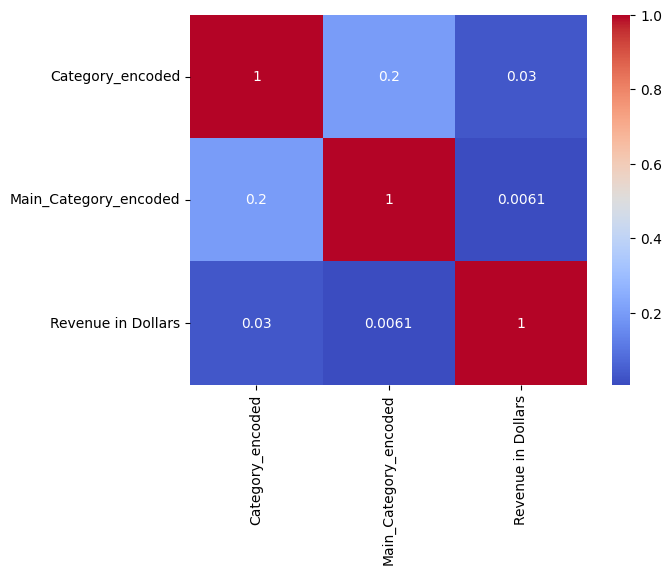

In [ ]:
#Secondly check with correlation matrix method

from sklearn.preprocessing import LabelEncoder


label_encoder = LabelEncoder()

df['Category_encoded'] = label_encoder.fit_transform(df['Category'])
df['Main_Category_encoded'] = label_encoder.fit_transform(df['Main Category'])

df_encoded = df[['Category_encoded', 'Main_Category_encoded']].copy()
df_encoded['Revenue in Dollars'] = df['Revenue in Dollars']

corr_matrix = df_encoded.corr()

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.show()


In [ ]:
df.columns

Index(['Category', 'Main Category', 'Currency', 'Deadline', 'Publication Date',
       'Investors', 'Country', 'Revenue in Dollars', 'Goal in Dollars',
       'Category_encoded', 'Main_Category_encoded'],
      dtype='object')

/tmp/ipython-input-1387070917.py:6: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Category_encoded', y='Revenue in Dollars', data=df, ci=None)


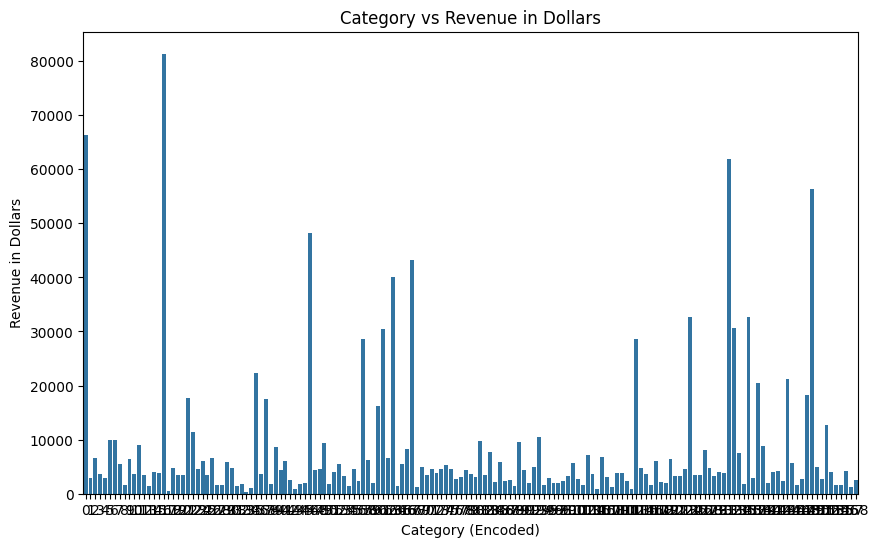

/tmp/ipython-input-1387070917.py:14: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='Main_Category_encoded', y='Revenue in Dollars', data=df, ci=None)


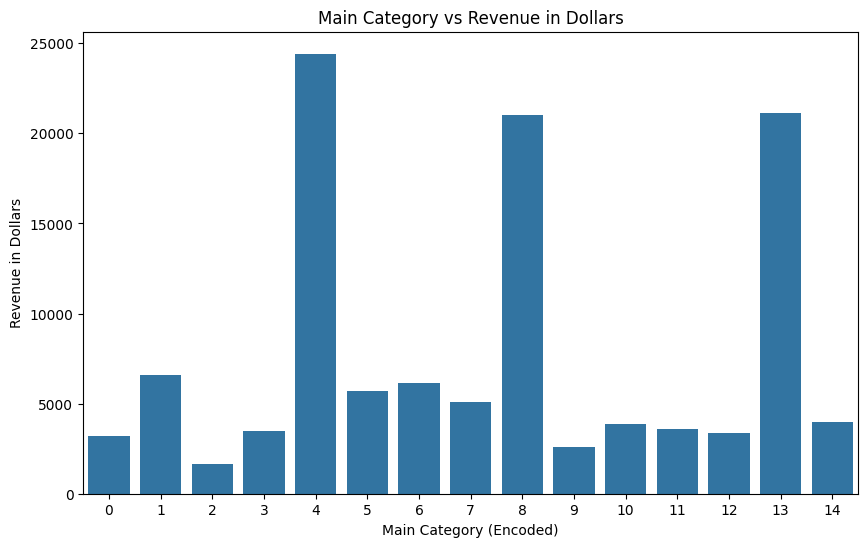

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Bar plot for Category_encoded vs Revenue in Dollars
plt.figure(figsize=(10, 6))
sns.barplot(x='Category_encoded', y='Revenue in Dollars', data=df, ci=None)
plt.title('Category vs Revenue in Dollars')
plt.xlabel('Category (Encoded)')
plt.ylabel('Revenue in Dollars')
plt.show()

# Bar plot for Main_Category_encoded vs Revenue in Dollars
plt.figure(figsize=(10, 6))
sns.barplot(x='Main_Category_encoded', y='Revenue in Dollars', data=df, ci=None)
plt.title('Main Category vs Revenue in Dollars')
plt.xlabel('Main Category (Encoded)')
plt.ylabel('Revenue in Dollars')
plt.show()


In [ ]:
#At result just keep main_category for ML

df.drop(columns=['Category'], inplace=True)

In [ ]:
df.head(5)

,Main Category,Currency,Deadline,Publication Date,Investors,Country,Revenue in Dollars,Goal in Dollars,Category_encoded,Main_Category_encoded
0,Music,USD,2013-01-10,2012-12-09 06:03:52,23,US,600.00,600.00,90,10
1,Games,USD,2012-04-29,2012-03-30 23:40:45,5,US,71.00,9000.00,62,8
2,Fashion,CAD,2017-07-22,2017-05-23 23:00:13,8,CA,360.36,2391.77,2,5
3,Fashion,USD,2016-11-18,2016-10-19 22:06:41,20,US,502.00,10000.00,2,5
4,Food,USD,2015-05-17,2015-04-17 18:10:47,62,US,2414.00,1400.00,58,7


##**Data Visualization part**

In [ ]:
top_5_country = df['Country'].value_counts().nlargest(5).reset_index(name='Country_count')
top_5_country

,Country,Country_count
0,US,292627
1,GB,33672
2,CA,14756
3,AU,7839
4,DE,4171


In [ ]:
fig = px.histogram(
    top_5_country,
    x='Country',
    y='Country_count',
    nbins=30,
    color_discrete_sequence=['#1f77b4'])

fig.update_layout(
  showlegend=False,
  xaxis_title='Country',
  yaxis_title="Count",
  bargap=0.1)

fig.show()



In [ ]:
top_5_music = df['Main Category'].value_counts().nlargest(5).reset_index(name='Cat_count')
top_5_music

,Main Category,Cat_count
0,Film & Video,63585
1,Music,51918
2,Publishing,39874
3,Games,35231
4,Technology,32569


In [ ]:
fig = px.histogram(
    top_5_music,
    x='Main Category',
    y='Cat_count',
    nbins=30,
    color_discrete_sequence=['#1f77b4'])

fig.update_layout(
  showlegend=False,
  xaxis_title='Main Category',
  yaxis_title="Count",
  bargap=0.1)

fig.show()



In [ ]:
# Check invidual correlation between features and target column

fig = px.scatter(
              df,
              x='Revenue in Dollars',
              y='Goal in Dollars',
              title=f"Correlation between Revenue in Dollars and Goal in Dollars")
fig.show()

In [ ]:
df.columns


Index(['Main Category', 'Currency', 'Deadline', 'Publication Date',
       'Investors', 'Country', 'Revenue in Dollars', 'Goal in Dollars',
       'Category_encoded', 'Main_Category_encoded'],
      dtype='object')

In [ ]:
fig = px.scatter(
              df,
              x='Revenue in Dollars',
              y='Main_Category_encoded',
              title=f"Correlation between Revenue in Dollars and Goal in Dollars")
fig.show()

In [ ]:
fig = px.scatter(
              df,
              x='Currency',
              y='Revenue in Dollars',
              )
fig.show()

In [ ]:
df.head(5)

,Main Category,Currency,Deadline,Publication Date,Investors,Country,Revenue in Dollars,Goal in Dollars,Category_encoded,Main_Category_encoded
0,Music,USD,2013-01-10,2012-12-09 06:03:52,23,US,600.00,600.00,90,10
1,Games,USD,2012-04-29,2012-03-30 23:40:45,5,US,71.00,9000.00,62,8
2,Fashion,CAD,2017-07-22,2017-05-23 23:00:13,8,CA,360.36,2391.77,2,5
3,Fashion,USD,2016-11-18,2016-10-19 22:06:41,20,US,502.00,10000.00,2,5
4,Food,USD,2015-05-17,2015-04-17 18:10:47,62,US,2414.00,1400.00,58,7


In [ ]:
df.drop(columns=['Category_encoded', 'Main_Category_encoded'], inplace=True)

In [ ]:
df.drop(columns=['Deadline', 'Publication Date'], inplace=True)

In [ ]:
df.head(5)

,Main Category,Currency,Investors,Country,Revenue in Dollars,Goal in Dollars
0,Music,USD,23,US,600.00,600.00
1,Games,USD,5,US,71.00,9000.00
2,Fashion,CAD,8,CA,360.36,2391.77
3,Fashion,USD,20,US,502.00,10000.00
4,Food,USD,62,US,2414.00,1400.00


In [ ]:
def outliers(data, column):

  Q1 = data[column].quantile(0.25)
  Q3 = data[column].quantile(0.75)
  IQR = Q3 - Q1
  lower_bound = Q1 - 1.5 * IQR
  upper_bound = Q3 + 1.5 * IQR
  return data[(data[column] < lower_bound) | (data[column] > upper_bound)]

len_outliers = {}

for i in df.select_dtypes(include=np.number).columns:
  outliers_iqr = outliers(df, i)
  len_outliers[i] = len(outliers_iqr)

len_outliers


{'Investors': 45343, 'Revenue in Dollars': 50578, 'Goal in Dollars': 45508}

In [ ]:
for i in df.select_dtypes(include=np.number).columns:
  fig = px.histogram(
      df,
      x=df[i],
      nbins=30,
      color_discrete_sequence=['#1f77b4'])

  fig.update_layout(
    showlegend=False,
    xaxis_title=df[i].name,
    yaxis_title="Count",
    bargap=0.1
   )


  fig.show()


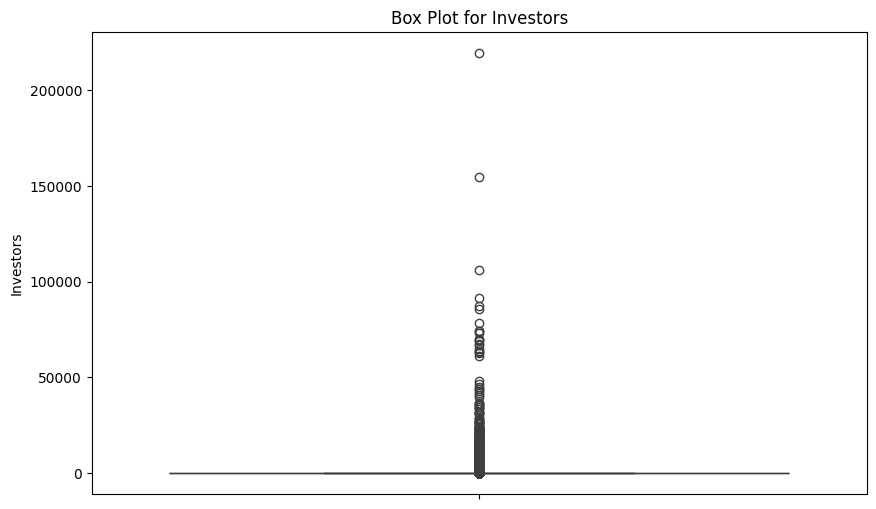

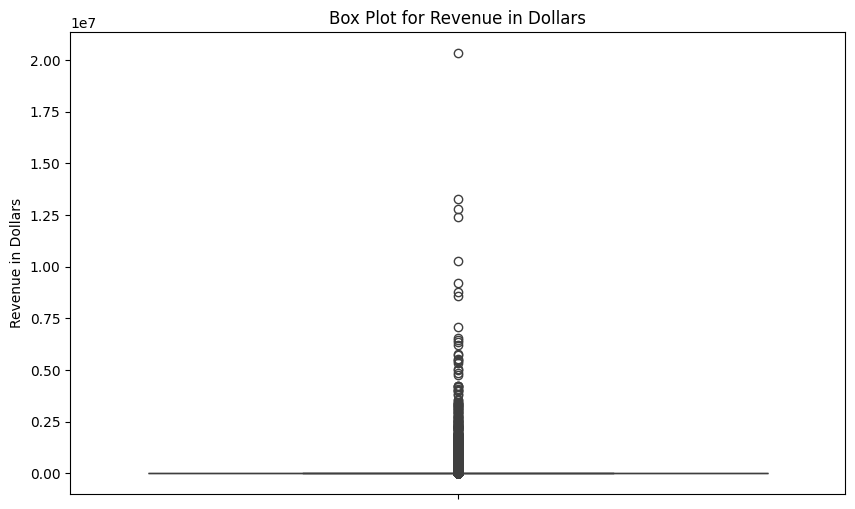

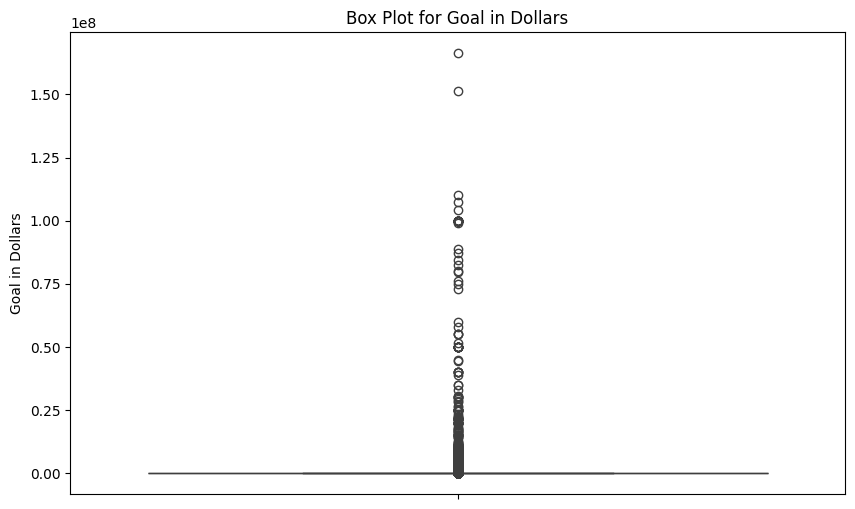

In [ ]:
for i in df.select_dtypes(include=np.number).columns:
    plt.figure(figsize=(10, 6))
    sns.boxplot(
        y=df[i],
        color='#1f77b4'
    )

    plt.title(f'Box Plot for {df[i].name}')
    plt.ylabel(df[i].name)

    plt.show()


In [ ]:
from scipy.stats import mstats

# Winsorization
def winsorize_column(data, column, limits=(0.15, 0.25)):
    """Apply winsorization to handle extreme values"""
    return mstats.winsorize(data[column], limits=limits)

df['Investors_win'] = winsorize_column(df, 'Investors')
df['Revenue_win'] = winsorize_column(df, 'Revenue in Dollars')
df['Goal_win'] = winsorize_column(df, 'Goal in Dollars')


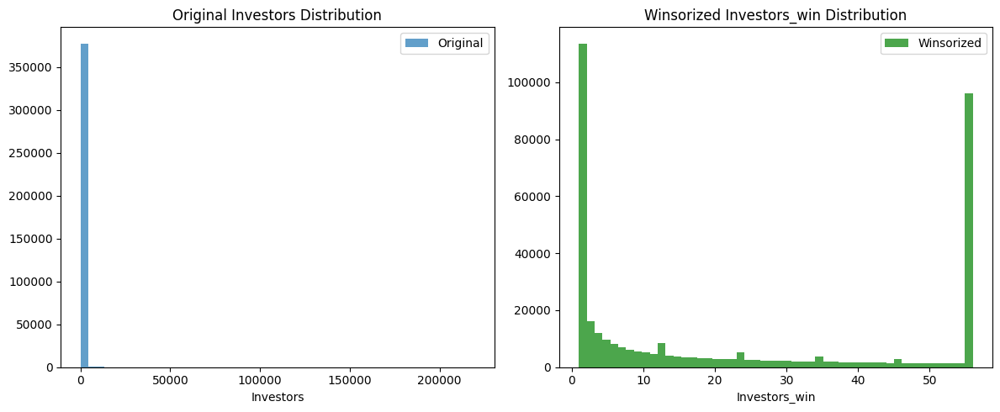

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

ax1.hist(df['Investors'], bins=50, alpha=0.7, label='Original')
ax1.set_title('Original Investors Distribution')
ax1.set_xlabel('Investors')
ax1.legend()

ax2.hist(df['Investors_win'], bins=50, alpha=0.7,
         color='green', label='Winsorized')
ax2.set_title('Winsorized Investors_win Distribution')
ax2.set_xlabel('Investors_win')
ax2.legend()

plt.tight_layout()

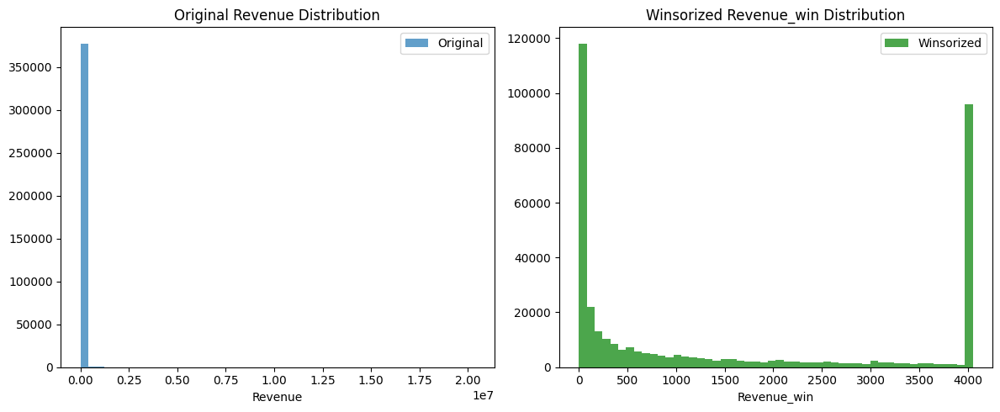

In [ ]:
# Revenue in Dollars
# Revenue_win


fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

ax1.hist(df['Revenue in Dollars'], bins=50, alpha=0.7, label='Original')
ax1.set_title('Original Revenue Distribution')
ax1.set_xlabel('Revenue')
ax1.legend()

ax2.hist(df['Revenue_win'], bins=50, alpha=0.7,
         color='green', label='Winsorized')
ax2.set_title('Winsorized Revenue_win Distribution')
ax2.set_xlabel('Revenue_win')
ax2.legend()

plt.tight_layout()

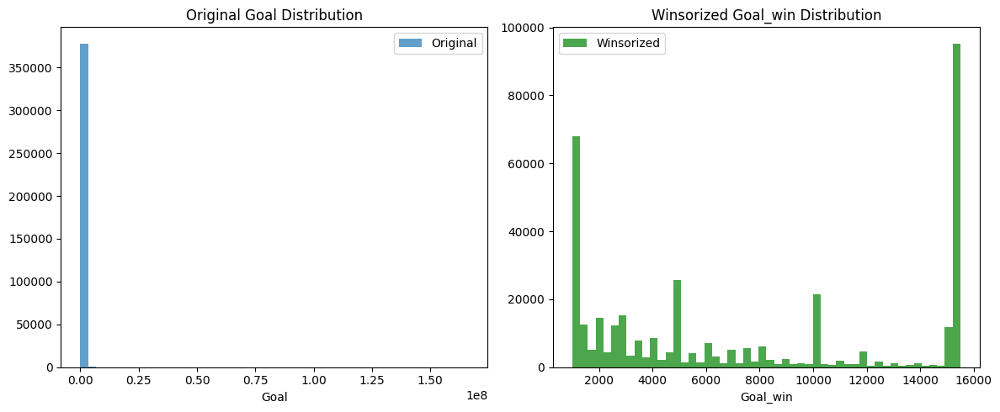

In [ ]:
# Goal_win
# Goal in Dollars

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

ax1.hist(df['Goal in Dollars'], bins=50, alpha=0.7, label='Original')
ax1.set_title('Original Goal Distribution')
ax1.set_xlabel('Goal')
ax1.legend()

ax2.hist(df['Goal_win'], bins=50, alpha=0.7,
         color='green', label='Winsorized')
ax2.set_title('Winsorized Goal_win Distribution')
ax2.set_xlabel('Goal_win')
ax2.legend()

plt.tight_layout()

In [ ]:
df.drop(columns=['Investors', 'Revenue in Dollars', 'Goal in Dollars'], inplace=True)

EDA and Feature Engineering process for second dataset

In [ ]:
df_extra.drop(columns=['Unnamed: 0'], inplace=True)
df_extra.drop(columns=['dlk_cob_date'], inplace=True)

In [ ]:
print(df.shape)
print(df_extra.shape)

(378661, 6)
(34055, 15)


In [ ]:
df_extra.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34055 entries, 0 to 34054
Data columns (total 15 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Close_brent                      34055 non-null  float64
 1   Close_sugar                      34055 non-null  float64
 2   Close_cereals                    34055 non-null  float64
 3   Close_index_moex                 34055 non-null  float64
 4   Close_index_moex_10              34055 non-null  float64
 5   Close_index_RGBI                 34055 non-null  float64
 6   Close_index_RTS_oil_and_gas      34055 non-null  float64
 7   Close_index_RTS_metallurgy       34055 non-null  float64
 8   Close_index_RTS_consumer_sector  34055 non-null  float64
 9   Close_index_RTS_telecom          34055 non-null  float64
 10  Close_index_RTS_finance          34055 non-null  float64
 11  Close_index_RTS_transport        34055 non-null  float64
 12  Close_index_RTS_ch

In [ ]:
df.isnull().sum()

,0
Main Category,0
Currency,0
Country,0
Investors_win,0
Revenue_win,0
Goal_win,0


In [ ]:
def outliers(data, column):

  Q1 = data[column].quantile(0.25)
  Q3 = data[column].quantile(0.75)
  IQR = Q3 - Q1
  lower_bound = Q1 - 1.5 * IQR
  upper_bound = Q3 + 1.5 * IQR
  return data[(data[column] < lower_bound) | (data[column] > upper_bound)]

len_outliers = {}

for i in df_extra.select_dtypes(include=np.number).columns:
  outliers_iqr = outliers(df_extra, i)
  len_outliers[i] = len(outliers_iqr)

len_outliers

{'Close_brent': 1286,
 'Close_sugar': 1284,
 'Close_cereals': 1285,
 'Close_index_moex': 1287,
 'Close_index_moex_10': 1287,
 'Close_index_RGBI': 1286,
 'Close_index_RTS_oil_and_gas': 1287,
 'Close_index_RTS_metallurgy': 1287,
 'Close_index_RTS_consumer_sector': 1286,
 'Close_index_RTS_telecom': 1287,
 'Close_index_RTS_finance': 1287,
 'Close_index_RTS_transport': 1287,
 'Close_index_RTS_chemicals': 1287,
 'Close_index_RTS_broad_market': 1287,
 'Close_index_RTS_electricity': 1287}

In [ ]:
for i in df_extra.select_dtypes(include=np.number).columns:
  fig = px.histogram(
      df_extra,
      x=df_extra[i],
      nbins=30,
      color_discrete_sequence=['#1f77b4'])

  fig.update_layout(
    showlegend=False,
    xaxis_title=df_extra[i].name,
    yaxis_title="Count",
    bargap=0.1
   )


  fig.show()

In [ ]:
print(df_extra['Close_index_RTS_chemicals'].min())
print(df_extra['Close_index_RTS_chemicals'].max())

177.38
439.88


In [ ]:
print(df_extra['Close_cereals'].min())
print(df_extra['Close_cereals'].max())

361.0
856.2


In [ ]:
#Sual var burda: Bu hissenide birləşdirib train_test etmək lazımdı ya yox


df_combined = pd.concat([df, df_extra], axis=1, ignore_index=False)

numeric_cols = df_combined.select_dtypes(include=np.number).columns
imputer = SimpleImputer(strategy='median')
df_combined[numeric_cols] = imputer.fit_transform(df_combined[numeric_cols])

print(df_combined.isnull().sum())

Main Category                      0
Currency                           0
Country                            0
Investors_win                      0
Revenue_win                        0
Goal_win                           0
Close_brent                        0
Close_sugar                        0
Close_cereals                      0
Close_index_moex                   0
Close_index_moex_10                0
Close_index_RGBI                   0
Close_index_RTS_oil_and_gas        0
Close_index_RTS_metallurgy         0
Close_index_RTS_consumer_sector    0
Close_index_RTS_telecom            0
Close_index_RTS_finance            0
Close_index_RTS_transport          0
Close_index_RTS_chemicals          0
Close_index_RTS_broad_market       0
Close_index_RTS_electricity        0
dtype: int64


In [ ]:
df_combined.head(5)

,Main Category,Currency,Country,Investors_win,Revenue_win,Goal_win,Close_brent,Close_sugar,Close_cereals,Close_index_moex,Close_index_moex_10,Close_index_RGBI,Close_index_RTS_oil_and_gas,Close_index_RTS_metallurgy,Close_index_RTS_consumer_sector,Close_index_RTS_telecom,Close_index_RTS_finance,Close_index_RTS_transport,Close_index_RTS_chemicals,Close_index_RTS_broad_market,Close_index_RTS_electricity
0,Music,USD,US,23.0,600.00,1000.00,34.41,13.97,442.75,1797.27,3940.81,125.59,123.40,111.97,196.55,70.17,140.57,27.06,177.38,530.59,32.49
1,Games,USD,US,5.0,71.00,9000.00,35.06,14.24,445.25,1803.89,3977.35,126.44,124.22,112.51,198.03,70.56,142.64,27.43,179.48,536.20,33.07
2,Fashion,CAD,CA,8.0,360.36,2391.77,35.13,14.00,443.25,1816.73,4027.23,126.90,125.38,113.44,200.13,71.94,145.45,28.06,181.56,544.73,33.55
3,Fashion,USD,US,20.0,502.00,10000.00,36.64,14.36,445.00,1840.17,4084.24,126.87,126.69,114.66,200.32,72.41,147.22,28.49,186.76,552.82,34.41
4,Food,USD,US,56.0,2414.00,1400.00,36.60,14.39,438.50,1844.17,4087.06,127.78,129.72,117.09,204.30,74.26,150.04,30.12,190.67,565.45,34.96


In [ ]:
X = df_combined.drop('Revenue_win', axis=1)
y = df_combined['Revenue_win']

In [ ]:
print(X)
print('\n')
print(y)

       Main Category Currency Country  Investors_win  Goal_win  Close_brent  \
0              Music      USD      US           23.0   1000.00        34.41   
1              Games      USD      US            5.0   9000.00        35.06   
2            Fashion      CAD      CA            8.0   2391.77        35.13   
3            Fashion      USD      US           20.0  10000.00        36.64   
4               Food      USD      US           56.0   1400.00        36.60   
...              ...      ...     ...            ...       ...          ...   
378656        Crafts      NZD      NZ            1.0   1000.00        56.95   
378657         Music      GBP      GB            1.0   2501.45        56.95   
378658         Music      USD      US            1.0   1500.00        56.95   
378659    Technology      USD      US            1.0  15500.00        56.95   
378660         Dance      USD      US           56.0   4000.00        56.95   

        Close_sugar  Close_cereals  Close_index_moe

In [ ]:
#Train-test split dataset:

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
#Scaling for train dataset

from sklearn.preprocessing import StandardScaler

num_cols_train = X_train.select_dtypes(include=np.number)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(num_cols_train)
X_train_scaled = pd.DataFrame(X_train_scaled, columns=num_cols_train.columns)

#---------------------------------------------------------------------------

#Sclaing for test dataset

num_cols_test = X_test.select_dtypes(include=np.number)
X_test_scaled = scaler.transform(num_cols_test)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=num_cols_test.columns)



In [ ]:
print("Scaled Training Data:")
print(X_train_scaled.head())

print("\nScaled Test Data:")
print(X_test_scaled.head())

Scaled Training Data:
   Investors_win  Goal_win  Close_brent  Close_sugar  Close_cereals  \
0       1.451431  1.377376    -0.002824     0.048962      -0.045456   
1      -0.913053 -1.051238    -0.002824     0.048962      -0.045456   
2      -0.956839 -0.351625    -0.002824     0.048962      -0.045456   
3       0.356763  0.423278    -0.002824     0.048962      -0.045456   
4      -0.606545  1.377376    -0.002824     0.048962      -0.045456   

   Close_index_moex  Close_index_moex_10  Close_index_RGBI  \
0         -0.030782             0.018234         -0.039953   
1         -0.030782             0.018234         -0.039953   
2         -0.030782             0.018234         -0.039953   
3         -0.030782             0.018234         -0.039953   
4         -0.030782             0.018234         -0.039953   

   Close_index_RTS_oil_and_gas  Close_index_RTS_metallurgy  \
0                    -0.020973                   -0.028809   
1                    -0.020973                   -0.02

In [ ]:
from sklearn.preprocessing import OneHotEncoder

#Onehot encoding for train dataset part

cat_column_train = X_train.select_dtypes(include='object')
one_hot = OneHotEncoder(drop='first')
X_train_encoded = one_hot.fit_transform(cat_column_train)

train_encoded_df = pd.DataFrame(X_train_encoded.toarray(), columns=one_hot.get_feature_names_out(cat_column_train.columns))
#-----------------------------------------------------#

#Onehot encoding for test dataset part

cat_column_test = X_test.select_dtypes(include='object')
X_test_encoded = one_hot.transform(cat_column_test)
test_encoded_df = pd.DataFrame(X_test_encoded.toarray(), columns=one_hot.get_feature_names_out(cat_column_test.columns))

In [ ]:
print("Encoded Training Data:")
print(train_encoded_df.head())

print("\nEncoded Test Data:")
print(test_encoded_df.head())

Encoded Training Data:
   Main Category_Comics  Main Category_Crafts  Main Category_Dance  \
0                   0.0                   0.0                  0.0   
1                   0.0                   0.0                  0.0   
2                   0.0                   0.0                  0.0   
3                   0.0                   0.0                  0.0   
4                   0.0                   0.0                  0.0   

   Main Category_Design  Main Category_Fashion  Main Category_Film & Video  \
0                   1.0                    0.0                         0.0   
1                   0.0                    0.0                         0.0   
2                   0.0                    0.0                         0.0   
3                   0.0                    0.0                         1.0   
4                   0.0                    0.0                         0.0   

   Main Category_Food  Main Category_Games  Main Category_Journalism  \
0              

In [ ]:
# Concant train_test scaled, encode dataset. Create 2 main dataframe:
# 1. Train scaled, encoded
# 2. Test scaled, encoded

#Train
X_train_final = pd.concat([X_train_scaled, train_encoded_df], axis=1)
X_test_final = pd.concat([X_test_scaled, test_encoded_df], axis=1)


In [ ]:
print("Combined Scaled and One-Hot Encoded Training Data:")
X_train_final.head()



Combined Scaled and One-Hot Encoded Training Data:


,Investors_win,Goal_win,Close_brent,Close_sugar,Close_cereals,Close_index_moex,Close_index_moex_10,Close_index_RGBI,Close_index_RTS_oil_and_gas,Close_index_RTS_metallurgy,Close_index_RTS_consumer_sector,Close_index_RTS_telecom,Close_index_RTS_finance,Close_index_RTS_transport,Close_index_RTS_chemicals,Close_index_RTS_broad_market,Close_index_RTS_electricity,Main Category_Comics,Main Category_Crafts,Main Category_Dance,Main Category_Design,Main Category_Fashion,Main Category_Film & Video,Main Category_Food,Main Category_Games,Main Category_Journalism,Main Category_Music,Main Category_Photography,Main Category_Publishing,Main Category_Technology,Main Category_Theater,Currency_CAD,Currency_CHF,Currency_DKK,Currency_EUR,Currency_GBP,Currency_HKD,Currency_JPY,Currency_MXN,Currency_NOK,Currency_NZD,Currency_SEK,Currency_SGD,Currency_USD,Country_AU,Country_BE,Country_CA,Country_CH,Country_DE,Country_DK,Country_ES,Country_FR,Country_GB,Country_HK,Country_IE,Country_IT,Country_JP,Country_LU,Country_MX,"Country_N,0""",Country_NL,Country_NO,Country_NZ,Country_SE,Country_SG,Country_US
0,1.451431,1.377376,-0.002824,0.048962,-0.045456,-0.030782,0.018234,-0.039953,-0.020973,-0.028809,0.031438,-0.018255,0.038161,0.037311,-0.016429,-0.020566,0.036688,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,-0.913053,-1.051238,-0.002824,0.048962,-0.045456,-0.030782,0.018234,-0.039953,-0.020973,-0.028809,0.031438,-0.018255,0.038161,0.037311,-0.016429,-0.020566,0.036688,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,-0.956839,-0.351625,-0.002824,0.048962,-0.045456,-0.030782,0.018234,-0.039953,-0.020973,-0.028809,0.031438,-0.018255,0.038161,0.037311,-0.016429,-0.020566,0.036688,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.356763,0.423278,-0.002824,0.048962,-0.045456,-0.030782,0.018234,-0.039953,-0.020973,-0.028809,0.031438,-0.018255,0.038161,0.037311,-0.016429,-0.020566,0.036688,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,-0.606545,1.377376,-0.002824,0.048962,-0.045456,-0.030782,0.018234,-0.039953,-0.020973,-0.028809,0.031438,-0.018255,0.038161,0.037311,-0.016429,-0.020566,0.036688,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [ ]:
print("\nCombined Scaled and One-Hot Encoded Test Data:")
X_test_final.head()


Combined Scaled and One-Hot Encoded Test Data:


,Investors_win,Goal_win,Close_brent,Close_sugar,Close_cereals,Close_index_moex,Close_index_moex_10,Close_index_RGBI,Close_index_RTS_oil_and_gas,Close_index_RTS_metallurgy,Close_index_RTS_consumer_sector,Close_index_RTS_telecom,Close_index_RTS_finance,Close_index_RTS_transport,Close_index_RTS_chemicals,Close_index_RTS_broad_market,Close_index_RTS_electricity,Main Category_Comics,Main Category_Crafts,Main Category_Dance,Main Category_Design,Main Category_Fashion,Main Category_Film & Video,Main Category_Food,Main Category_Games,Main Category_Journalism,Main Category_Music,Main Category_Photography,Main Category_Publishing,Main Category_Technology,Main Category_Theater,Currency_CAD,Currency_CHF,Currency_DKK,Currency_EUR,Currency_GBP,Currency_HKD,Currency_JPY,Currency_MXN,Currency_NOK,Currency_NZD,Currency_SEK,Currency_SGD,Currency_USD,Country_AU,Country_BE,Country_CA,Country_CH,Country_DE,Country_DK,Country_ES,Country_FR,Country_GB,Country_HK,Country_IE,Country_IT,Country_JP,Country_LU,Country_MX,"Country_N,0""",Country_NL,Country_NO,Country_NZ,Country_SE,Country_SG,Country_US
0,-0.650332,-0.010403,-0.002824,0.048962,-0.045456,-0.030782,0.018234,-0.039953,-0.020973,-0.028809,0.031438,-0.018255,0.038161,0.037311,-0.016429,-0.020566,0.036688,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,-0.650332,0.423278,-0.002824,0.048962,-0.045456,-0.030782,0.018234,-0.039953,-0.020973,-0.028809,0.031438,-0.018255,0.038161,0.037311,-0.016429,-0.020566,0.036688,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,-0.825479,-0.955828,-0.002824,0.048962,-0.045456,-0.030782,0.018234,-0.039953,-0.020973,-0.028809,0.031438,-0.018255,0.038161,0.037311,-0.016429,-0.020566,0.036688,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,1.451431,-0.444084,-0.002824,0.048962,-0.045456,-0.030782,0.018234,-0.039953,-0.020973,-0.028809,0.031438,-0.018255,0.038161,0.037311,-0.016429,-0.020566,0.036688,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,-0.956839,-1.137974,-0.002824,0.048962,-0.045456,-0.030782,0.018234,-0.039953,-0.020973,-0.028809,0.031438,-0.018255,0.038161,0.037311,-0.016429,-0.020566,0.036688,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


##Check dataset with **Linear Regression** mode

In [ ]:
lr_model = LinearRegression()
lr_model.fit(X_train_final, y_train)
y_pred_lr = lr_model.predict(X_test_final)

print("Linear Regression Metrics:")
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_pred_lr))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_pred_lr))
print("Root Mean Squared Error (RMSE):", np.sqrt(mean_squared_error(y_test, y_pred_lr)))
print("R-squared (R²):", r2_score(y_test, y_pred_lr))


Linear Regression Metrics:
Mean Absolute Error (MAE): 409.0431777196576
Mean Squared Error (MSE): 440566.95936840866
Root Mean Squared Error (RMSE): 663.7521821948375
R-squared (R²): 0.845982727812759


In [ ]:
# Calculate MAE, MSE, RMSE, and R² for both training and test sets


y_train_pred = lr_model.predict(X_train_final)
y_test_pred = lr_model.predict(X_test_final)

mae_train = mean_absolute_error(y_train, y_train_pred)
mae_test = mean_absolute_error(y_test, y_test_pred)

mse_train = mean_squared_error(y_train, y_train_pred)
mse_test = mean_squared_error(y_test, y_test_pred)

rmse_train = np.sqrt(mse_train)
rmse_test = np.sqrt(mse_test)

r2_train = r2_score(y_train, y_train_pred)
r2_test = r2_score(y_test, y_test_pred)

In [ ]:
print("Training Data Evaluation Metrics:")
print(f"MAE: {mae_train}")
print(f"MSE: {mse_train}")
print(f"RMSE: {rmse_train}")
print(f"R²: {r2_train}")

print("\nTest Data Evaluation Metrics:")
print(f"MAE: {mae_test}")
print(f"MSE: {mse_test}")
print(f"RMSE: {rmse_test}")
print(f"R²: {r2_test}")

Training Data Evaluation Metrics:
MAE: 409.06502430952366
MSE: 440936.40981981455
RMSE: 664.0304283839819
R²: 0.8463667918740064

Test Data Evaluation Metrics:
MAE: 409.0431777196576
MSE: 440566.95936840866
RMSE: 663.7521821948375
R²: 0.845982727812759


##Check dataset with **Tree ML model**

In [ ]:
# Decision Tree Regressor
dt_model = DecisionTreeRegressor(random_state=42)
dt_model.fit(X_train_final, y_train)
y_pred_dt = dt_model.predict(X_test_final)

print("Decision Tree Regressor Metrics:")
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_pred_dt))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_pred_dt))
print("Root Mean Squared Error (RMSE):", np.sqrt(mean_squared_error(y_test, y_pred_dt)))
print("R-squared (R²):", r2_score(y_test, y_pred_dt))


Decision Tree Regressor Metrics:
Mean Absolute Error (MAE): 325.8778020399942
Mean Squared Error (MSE): 436261.99868970836
Root Mean Squared Error (RMSE): 660.501323760754
R-squared (R²): 0.8474876938264548


In [ ]:
# Calculate MAE, MSE, RMSE, and R² for both training and test sets

y_train_pred = dt_model.predict(X_train_final)
y_test_pred = dt_model.predict(X_test_final)

mae_train = mean_absolute_error(y_train, y_train_pred)
mae_test = mean_absolute_error(y_test, y_test_pred)

mse_train = mean_squared_error(y_train, y_train_pred)
mse_test = mean_squared_error(y_test, y_test_pred)

rmse_train = np.sqrt(mse_train)
rmse_test = np.sqrt(mse_test)

r2_train = r2_score(y_train, y_train_pred)
r2_test = r2_score(y_test, y_test_pred)

In [ ]:
print("Training Data Evaluation Metrics:")
print(f"MAE: {mae_train}")
print(f"MSE: {mse_train}")
print(f"RMSE: {rmse_train}")
print(f"R²: {r2_train}")

print("\nTest Data Evaluation Metrics:")
print(f"MAE: {mae_test}")
print(f"MSE: {mse_test}")
print(f"RMSE: {rmse_test}")
print(f"R²: {r2_test}")

#Overfitting !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!

Training Data Evaluation Metrics:
MAE: 212.04416520826814
MSE: 219228.80420185308
RMSE: 468.21875678132875
R²: 0.9236152339587483

Test Data Evaluation Metrics:
MAE: 325.8778020399942
MSE: 436261.99868970836
RMSE: 660.501323760754
R²: 0.8474876938264548


##Check dataset with **Random Forest Regressor**

In [ ]:
# Random Forest Regressor
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train_final, y_train)
y_pred_rf = rf_model.predict(X_test_final)

print("Random Forest Regressor Metrics:")
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_pred_rf))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_pred_rf))
print("Root Mean Squared Error (RMSE):", np.sqrt(mean_squared_error(y_test, y_pred_rf)))
print("R-squared (R²):", r2_score(y_test, y_pred_rf))


Random Forest Regressor Metrics:
Mean Absolute Error (MAE): 311.64357662548593
Mean Squared Error (MSE): 369993.78988828027
Root Mean Squared Error (RMSE): 608.2711483280135
R-squared (R²): 0.8706543170497721


In [ ]:
# Calculate MAE, MSE, RMSE, and R² for both training and test sets

y_train_pred = rf_model.predict(X_train_final)
y_test_pred = rf_model.predict(X_test_final)

mae_train = mean_absolute_error(y_train, y_train_pred)
mae_test = mean_absolute_error(y_test, y_test_pred)

mse_train = mean_squared_error(y_train, y_train_pred)
mse_test = mean_squared_error(y_test, y_test_pred)

rmse_train = np.sqrt(mse_train)
rmse_test = np.sqrt(mse_test)

r2_train = r2_score(y_train, y_train_pred)
r2_test = r2_score(y_test, y_test_pred)

In [ ]:
print("Training Data Evaluation Metrics:")
print(f"MAE: {mae_train}")
print(f"MSE: {mse_train}")
print(f"RMSE: {rmse_train}")
print(f"R²: {r2_train}")

print("\nTest Data Evaluation Metrics:")
print(f"MAE: {mae_test}")
print(f"MSE: {mse_test}")
print(f"RMSE: {rmse_test}")
print(f"R²: {r2_test}")

Training Data Evaluation Metrics:
MAE: 240.30904545956346
MSE: 232994.969506157
RMSE: 482.69552463862453
R²: 0.9188187597003463

Test Data Evaluation Metrics:
MAE: 311.64357662548593
MSE: 369993.78988828027
RMSE: 608.2711483280135
R²: 0.8706543170497721


##Check dataset with **Boosting Regressor**(Boosting) model

In [ ]:
# Gradient Boosting Regressor (Boosting)
gb_model = GradientBoostingRegressor(n_estimators=100, random_state=42)
gb_model.fit(X_train_final, y_train)
y_pred_gb = gb_model.predict(X_test_final)

print("Gradient Boosting Regressor Metrics:")
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_pred_gb))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_pred_gb))
print("Root Mean Squared Error (RMSE):", np.sqrt(mean_squared_error(y_test, y_pred_gb)))
print("R-squared (R²):", r2_score(y_test, y_pred_gb))


Gradient Boosting Regressor Metrics:
Mean Absolute Error (MAE): 314.1708011278917
Mean Squared Error (MSE): 341699.31060671736
Root Mean Squared Error (RMSE): 584.5505201492147
R-squared (R²): 0.8805457499505781


In [ ]:
# Calculate MAE, MSE, RMSE, and R² for both training and test sets

y_train_pred = gb_model.predict(X_train_final)
y_test_pred = gb_model.predict(X_test_final)

mae_train = mean_absolute_error(y_train, y_train_pred)
mae_test = mean_absolute_error(y_test, y_test_pred)

mse_train = mean_squared_error(y_train, y_train_pred)
mse_test = mean_squared_error(y_test, y_test_pred)

rmse_train = np.sqrt(mse_train)
rmse_test = np.sqrt(mse_test)

r2_train = r2_score(y_train, y_train_pred)
r2_test = r2_score(y_test, y_test_pred)

In [ ]:
print("Training Data Evaluation Metrics:")
print(f"MAE: {mae_train}")
print(f"MSE: {mse_train}")
print(f"RMSE: {rmse_train}")
print(f"R²: {r2_train}")

print("\nTest Data Evaluation Metrics:")
print(f"MAE: {mae_test}")
print(f"MSE: {mse_test}")
print(f"RMSE: {rmse_test}")
print(f"R²: {r2_test}")

Training Data Evaluation Metrics:
MAE: 314.19321316479335
MSE: 341046.2574285301
RMSE: 583.9916586977336
R²: 0.8811710045230337

Test Data Evaluation Metrics:
MAE: 314.1708011278917
MSE: 341699.31060671736
RMSE: 584.5505201492147
R²: 0.8805457499505781


#Check dataset with **Voting** model

In [ ]:
# Voting Regressor
voting_model = VotingRegressor(estimators=[
    ('lr', LinearRegression()),
    ('rf', RandomForestRegressor(n_estimators=100, random_state=42)),
    ('gb', GradientBoostingRegressor(n_estimators=100, random_state=42))
])

voting_model.fit(X_train_final, y_train)
y_pred_voting = voting_model.predict(X_test_final)

print("Voting Regressor Metrics:")
print("Mean Absolute Error (MAE):", mean_absolute_error(y_test, y_pred_voting))
print("Mean Squared Error (MSE):", mean_squared_error(y_test, y_pred_voting))
print("Root Mean Squared Error (RMSE):", np.sqrt(mean_squared_error(y_test, y_pred_voting)))
print("R-squared (R²):", r2_score(y_test, y_pred_voting))


Voting Regressor Metrics:
Mean Absolute Error (MAE): 333.0335678159393
Mean Squared Error (MSE): 349580.4824144783
Root Mean Squared Error (RMSE): 591.2533149289552
R-squared (R²): 0.8777905805996797


In [ ]:
# Calculate MAE, MSE, RMSE, and R² for both training and test sets

y_train_pred = voting_model.predict(X_train_final)
y_test_pred = voting_model.predict(X_test_final)

mae_train = mean_absolute_error(y_train, y_train_pred)
mae_test = mean_absolute_error(y_test, y_test_pred)

mse_train = mean_squared_error(y_train, y_train_pred)
mse_test = mean_squared_error(y_test, y_test_pred)

rmse_train = np.sqrt(mse_train)
rmse_test = np.sqrt(mse_test)

r2_train = r2_score(y_train, y_train_pred)
r2_test = r2_score(y_test, y_test_pred)

In [ ]:
print("Training Data Evaluation Metrics:")
print(f"MAE: {mae_train}")
print(f"MSE: {mse_train}")
print(f"RMSE: {rmse_train}")
print(f"R²: {r2_train}")

print("\nTest Data Evaluation Metrics:")
print(f"MAE: {mae_test}")
print(f"MSE: {mse_test}")
print(f"RMSE: {rmse_test}")
print(f"R²: {r2_test}")

Training Data Evaluation Metrics:
MAE: 310.52705313280325
MSE: 300659.199108317
RMSE: 548.3239910019596
R²: 0.8952428597799889

Test Data Evaluation Metrics:
MAE: 333.0335678159393
MSE: 349580.4824144783
RMSE: 591.2533149289552
R²: 0.8777905805996797
